# PART 1

# 1. Analysis of Real Estate Sales Data

- Author : Sriharsha Nemalikonda
- Link to the author's GitHub profile : https://github.com/nsriharsha04

# 2. Background

The project aims to analyze real estate sales data in Connecticut from 2001 to 2020 to gain insights into the real estate market trends, property types, and sales prices over the years. Understanding the patterns and trends in real estate sales is essential for various stakeholders, including homebuyers, investors, and policymakers. It can help in making informed decisions regarding property investments, policy adjustments, and market predictions.

# 3. Data

* Data sources - Office of Policy and Management [ https://portal.ct.gov/OPM/IGPP/Publications/Real-Estate-Sales-Listing ]

* Data dictionary - Here each row in the dataset represents a single real estate sale transaction

### 3.1 Import required libraries

In [1]:
import pandas as pd
import plotly.express as px
import plotly.graph_objs as go
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
from wordcloud import WordCloud
import missingno as msno
from scipy import stats


### 3.2 Read the input file

In [2]:
# Read csv file
data =  pd.read_csv('../data/Real_Estate_Sales_2001-2020_GL.csv')

In [3]:
# data= pd.read_csv('Real_Estate_Sales_2001-2020_GL.csv')

<ipython-input-3-2cca3e10be8c>:1: DtypeWarning: Columns (8,9,10,11,12) have mixed types. Specify dtype option on import or set low_memory=False.
  data= pd.read_csv('Real_Estate_Sales_2001-2020_GL.csv')


In [4]:
# Display the first 5 elements of the dataframe
data.head()

,Serial Number,List Year,Date Recorded,Town,Address,Assessed Value,Sale Amount,Sales Ratio,Property Type,Residential Type,Non Use Code,Assessor Remarks,OPM remarks,Location
0,2020348,2020,09/13/2021,Ansonia,230 WAKELEE AVE,150500.0,325000.0,0.4630,Commercial,NaN,NaN,NaN,NaN,NaN
1,20002,2020,10/02/2020,Ashford,390 TURNPIKE RD,253000.0,430000.0,0.5883,Residential,Single Family,NaN,NaN,NaN,NaN
2,200212,2020,03/09/2021,Avon,5 CHESTNUT DRIVE,130400.0,179900.0,0.7248,Residential,Condo,NaN,NaN,NaN,NaN
3,200243,2020,04/13/2021,Avon,111 NORTHINGTON DRIVE,619290.0,890000.0,0.6958,Residential,Single Family,NaN,NaN,NaN,NaN
4,200377,2020,07/02/2021,Avon,70 FAR HILLS DRIVE,862330.0,1447500.0,0.5957,Residential,Single Family,NaN,NaN,NaN,NaN


In [5]:
# Display the columns
data.columns

Index(['Serial Number', 'List Year', 'Date Recorded', 'Town', 'Address',
       'Assessed Value', 'Sale Amount', 'Sales Ratio', 'Property Type',
       'Residential Type', 'Non Use Code', 'Assessor Remarks', 'OPM remarks',
       'Location'],
      dtype='object')

### 3.3 Dataset info

In [6]:
# Display the data frame info
data.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 997213 entries, 0 to 997212
Data columns (total 14 columns):
 #   Column            Non-Null Count   Dtype  
---  ------            --------------   -----  
 0   Serial Number     997213 non-null  int64  
 1   List Year         997213 non-null  int64  
 2   Date Recorded     997211 non-null  object 
 3   Town              997213 non-null  object 
 4   Address           997162 non-null  object 
 5   Assessed Value    997213 non-null  float64
 6   Sale Amount       997213 non-null  float64
 7   Sales Ratio       997213 non-null  float64
 8   Property Type     614767 non-null  object 
 9   Residential Type  608904 non-null  object 
 10  Non Use Code      289681 non-null  object 
 11  Assessor Remarks  149864 non-null  object 
 12  OPM remarks       9934 non-null    object 
 13  Location          197697 non-null  object 
dtypes: float64(3), int64(2), object(9)
memory usage: 106.5+ MB


In [7]:
# Generate descriptive statistics.
data.describe()

,Serial Number,List Year,Assessed Value,Sale Amount,Sales Ratio
count,9.972130e+05,997213.000000,9.972130e+05,9.972130e+05,9.972130e+05
mean,4.311864e+05,2010.189829,2.791437e+05,3.911512e+05,1.044637e+01
std,6.549219e+06,6.237877,1.670610e+06,5.347270e+06,1.890192e+03
min,0.000000e+00,2001.000000,0.000000e+00,0.000000e+00,0.000000e+00
25%,3.044400e+04,2004.000000,8.760000e+04,1.400000e+05,4.867000e-01
50%,7.030300e+04,2010.000000,1.383900e+05,2.250000e+05,6.246000e-01
75%,1.518780e+05,2016.000000,2.255600e+05,3.650000e+05,7.852761e-01
max,2.000500e+09,2020.000000,8.815100e+08,5.000000e+09,1.226420e+06


### 3.4 Find the unique elements of the column

In [8]:
# Create a new DataFrame to store unique values, data type, definition, and potential values
unique_info_df = pd.DataFrame(columns=['Column Name', 'Data Type', 'Definition', 'Potential Values'])

# Loop through each column in the DataFrame
for column in data.columns:
    data_type = data[column].dtype
    definition = ''
    potential_values = data[column].unique()[:5]

    # Append the information to the new DataFrame
    unique_info_df = unique_info_df.append({'Column Name': column, 'Data Type': data_type,
                                            'Definition': definition, 'Potential Values': potential_values},
                                           ignore_index=True)

# Print the unique data in each column
unique_info_df

<ipython-input-8-8732e4d2ff74>:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  unique_info_df = unique_info_df.append({'Column Name': column, 'Data Type': data_type,
<ipython-input-8-8732e4d2ff74>:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  unique_info_df = unique_info_df.append({'Column Name': column, 'Data Type': data_type,
<ipython-input-8-8732e4d2ff74>:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  unique_info_df = unique_info_df.append({'Column Name': column, 'Data Type': data_type,
<ipython-input-8-8732e4d2ff74>:11: FutureWarning: The frame.append method is deprecated and will be removed from pandas in a future version. Use pandas.concat instead.
  unique_info_df = unique_info_df.append({'Column Name': colu

,Column Name,Data Type,Definition,Potential Values
0,Serial Number,int64,,"[2020348, 20002, 200212, 200243, 200377]"
1,List Year,int64,,"[2020, 2001, 2002, 2003, 2004]"
2,Date Recorded,object,,"[09/13/2021, 10/02/2020, 03/09/2021, 04/13/202..."
3,Town,object,,"[Ansonia, Ashford, Avon, Berlin, Bethany]"
4,Address,object,,"[230 WAKELEE AVE, 390 TURNPIKE RD, 5 CHESTNUT ..."
5,Assessed Value,float64,,"[150500.0, 253000.0, 130400.0, 619290.0, 86233..."
6,Sale Amount,float64,,"[325000.0, 430000.0, 179900.0, 890000.0, 14475..."
7,Sales Ratio,float64,,"[0.463, 0.5883, 0.7248, 0.6958, 0.5957]"
8,Property Type,object,,"[Commercial, Residential, Vacant Land, nan, Ap..."
9,Residential Type,object,,"[nan, Single Family, Condo, Two Family, Three ..."


In [9]:
# print(unique_info_df.to_string(index=False))

# 4. Exploratory Data Analysis (EDA)

### 4.1 Processing stop words

In [10]:
from sklearn.feature_extraction.text import ENGLISH_STOP_WORDS

# Text preprocessing function
def preprocess_text(x):
    if isinstance(x, str):
        return ' '.join([word for word in x.lower().split() if word not in ENGLISH_STOP_WORDS])
    elif pd.notna(x):  # Check for non-NaN values
        return str(x)  # Convert non-string values to strings
    else:
        return ''  # Handle NaN values by returning an empty string


# Apply text preprocessing to create a new column 'Processed Remarks'
data['Processed Remarks'] = data['Assessor Remarks'].apply(preprocess_text)

# Count words without stop words in the processed remarks
count_without_stop_words = data['Processed Remarks'].apply(lambda x: len(x.split())).sum()

print(f"Total words without stop words: {count_without_stop_words}")

Total words without stop words: 450735


The ENGLISH_STOP_WORDS set in scikit-learn contains a list of such common English stop words, and it can be used to filter out these words from text data when performing text analysis tasks

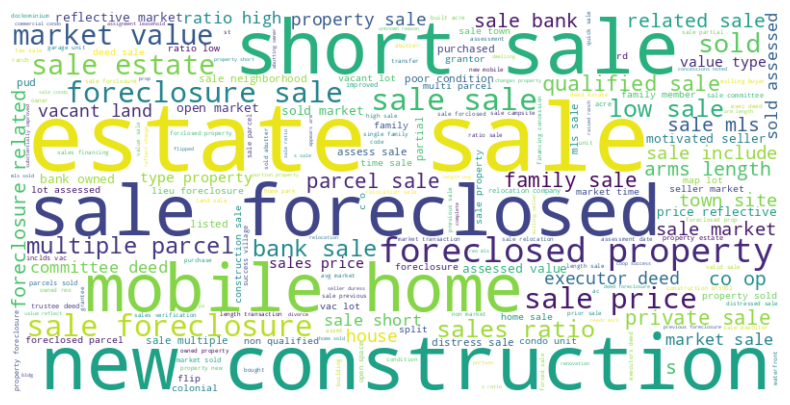

In [11]:
# Create a word cloud
wordcloud = WordCloud(width=800, height=400, background_color='white').generate(' '.join(data['Processed Remarks']))

# Display the word cloud
plt.figure(figsize=(10, 5))
plt.imshow(wordcloud, interpolation='bilinear')
plt.axis('off')
plt.show()

In [12]:
data.head()

,Serial Number,List Year,Date Recorded,Town,Address,Assessed Value,Sale Amount,Sales Ratio,Property Type,Residential Type,Non Use Code,Assessor Remarks,OPM remarks,Location,Processed Remarks
0,2020348,2020,09/13/2021,Ansonia,230 WAKELEE AVE,150500.0,325000.0,0.4630,Commercial,NaN,NaN,NaN,NaN,NaN,
1,20002,2020,10/02/2020,Ashford,390 TURNPIKE RD,253000.0,430000.0,0.5883,Residential,Single Family,NaN,NaN,NaN,NaN,
2,200212,2020,03/09/2021,Avon,5 CHESTNUT DRIVE,130400.0,179900.0,0.7248,Residential,Condo,NaN,NaN,NaN,NaN,
3,200243,2020,04/13/2021,Avon,111 NORTHINGTON DRIVE,619290.0,890000.0,0.6958,Residential,Single Family,NaN,NaN,NaN,NaN,
4,200377,2020,07/02/2021,Avon,70 FAR HILLS DRIVE,862330.0,1447500.0,0.5957,Residential,Single Family,NaN,NaN,NaN,NaN,


### 4.2 Checking null values

In [13]:
# Checking missing values
data.isnull().sum()

Serial Number             0
List Year                 0
Date Recorded             2
Town                      0
Address                  51
Assessed Value            0
Sale Amount               0
Sales Ratio               0
Property Type        382446
Residential Type     388309
Non Use Code         707532
Assessor Remarks     847349
OPM remarks          987279
Location             799516
Processed Remarks         0
dtype: int64

### 4.3 Data Cleansing and Data Visualization

#### 4.3.0 Cleaning Data

In [14]:
# Clean the columns

data['Date Recorded'] = pd.to_datetime(data['Date Recorded'], errors='coerce')

# Check for rows with invalid dates (NaT represents invalid dates)
invalid_dates = data[data['Date Recorded'].isna()]['Date Recorded']
print("Invalid Date Values:")
print(invalid_dates)

# Drop rows with invalid dates (if necessary)
data = data.dropna(subset=['Date Recorded'])

# Format the datetime column to "mm/dd/yyyy"
data['Date Recorded'] = data['Date Recorded'].dt.strftime('%m/%d/%Y')

Invalid Date Values:
177917   NaT
179410   NaT
Name: Date Recorded, dtype: datetime64[ns]


In [15]:
data.isnull().sum()

Serial Number             0
List Year                 0
Date Recorded             0
Town                      0
Address                  49
Assessed Value            0
Sale Amount               0
Sales Ratio               0
Property Type        382444
Residential Type     388307
Non Use Code         707530
Assessor Remarks     847347
OPM remarks          987277
Location             799514
Processed Remarks         0
dtype: int64

#### 4.3.1 Missing Data Plot

<Figure size 800x500 with 0 Axes>

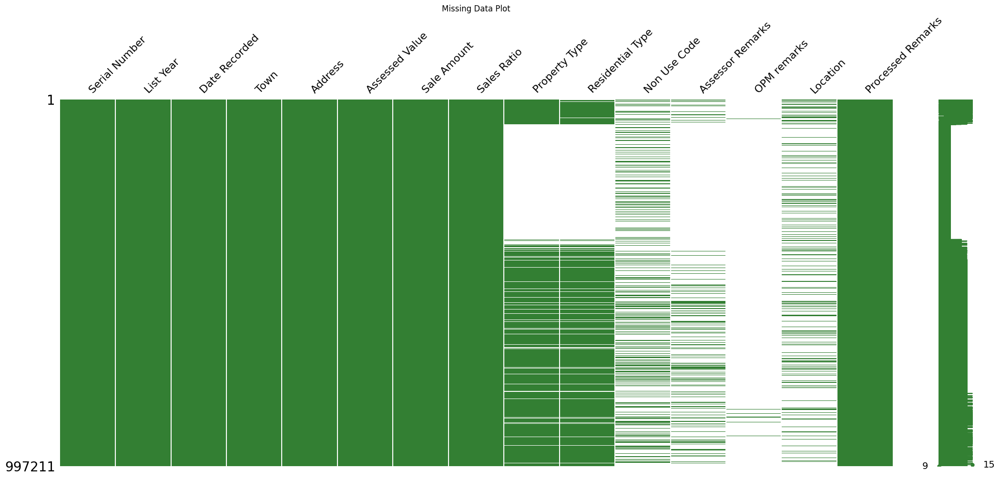

In [16]:
plt.figure(figsize=(8, 5))
msno.matrix(data, color=(0.2, 0.5, 0.2))
plt.title('Missing Data Plot')
plt.show()

In [17]:
# Calculate the Z-score for each data point
z_scores = stats.zscore(data['Assessed Value'])

# Define a threshold for identifying outliers (e.g., Z-score greater than 3)
threshold = 3

# Create a mask for identifying outliers
outlier_mask = (z_scores > threshold) | (z_scores < -threshold)

# Remove rows with outliers
data_no_outliers = data[~outlier_mask]

# Optional: You can reset the index of the cleaned DataFrame
data_no_outliers.reset_index(drop=True, inplace=True)

data= data_no_outliers
# Now, data_no_outliers contains the DataFrame with outliers removed

#### 4.3.2 Assessed Value vs Sale Amount

In [18]:
fig = px.scatter(data, x='Assessed Value', y='Sale Amount', title='Scatter Plot: Assessed Value vs Sale Amount')

# Show the plot
fig.show()


#### 4.3.3 Number of Properties by Type

In [19]:
property_counts = data['Property Type'].value_counts().reset_index()
property_counts.columns = ['Property Type', 'Count']

trace = go.Bar(
    x=property_counts['Property Type'],
    y=property_counts['Count']
)

layout = go.Layout(
    title="Number of Properties by Type",
    xaxis=dict(title="Property Type"),
    yaxis=dict(title="Count"),
)

fig = go.Figure(data=[trace], layout=layout)
fig.show()


* Large number of properties are of Residential type.

#### 4.3.4 Distribution of Residential Types

In [20]:
residential_counts = data['Residential Type'].value_counts().reset_index()
residential_counts.columns = ['Residential Type', 'Count']

trace = go.Pie(
    labels=residential_counts['Residential Type'],
    values=residential_counts['Count'],
)

layout = go.Layout(title="Distribution of Residential Types")

fig = go.Figure(data=[trace], layout=layout)
fig.show()


* Large share of the residential types are owned by four family.

#### 4.3.5 Total Sales Amount Over Years

In [21]:
data['Date Recorded'] = pd.to_datetime(data['Date Recorded'])
data['Year'] = data['Date Recorded'].dt.year
sales_over_years = data.groupby('Year')['Sale Amount'].sum().reset_index()

trace = go.Scatter(
    x=sales_over_years['Year'],
    y=sales_over_years['Sale Amount'],
    mode='lines+markers',
)

layout = go.Layout(
    title="Total Sales Amount Over Years",
    xaxis=dict(title="Year"),
    yaxis=dict(title="Total Sales Amount"),
)

fig = go.Figure(data=[trace], layout=layout)
fig.show()


* Total sales in 2021 highest among all years.

#### 4.3.6 Bar Chart for List Year

In [22]:
# Calculate the count of records by List Year
year_counts = data['List Year'].value_counts().sort_index()

# Create a bar trace
trace = go.Bar(
    x=year_counts.index,
    y=year_counts.values,
    marker=dict(color='blue'),
)

layout = go.Layout(
    title='Count of Records by List Year',
    xaxis=dict(title='List Year'),
    yaxis=dict(title='Count'),
)

fig = go.Figure(data=[trace], layout=layout)
fig.show()


#### 4.3.7 Histogram for Assessed Value

In [23]:
# Create a histogram trace
trace = go.Histogram(
    x=data['Assessed Value'],
    nbinsx=100,  # Number of bins
    marker=dict(color='green'),
)

layout = go.Layout(
    title='Distribution of Assessed Values',
    xaxis=dict(title='Assessed Value'),
    yaxis=dict(title='Frequency'),
)

fig = go.Figure(data=[trace], layout=layout)
fig.show()

#### 4.3.8 Time Series Plot for Date Recorded

In [24]:
# Assuming data is your DataFrame
data['Date Recorded'] = pd.to_datetime(data['Date Recorded'])
data.set_index('Date Recorded', inplace=True)

# Resample data to monthly frequency and calculate the count
monthly_count = data['Year'].resample('M').count()

# Create a line plot trace
trace = go.Scatter(
    x=monthly_count.index,
    y=monthly_count.values,
    mode='lines+markers',
)

layout = go.Layout(
    title='Time Series of Date Recorded',
    xaxis=dict(title='Date Recorded'),
    yaxis=dict(title='Count'),
)

fig = go.Figure(data=[trace], layout=layout)
fig.show()


#### 4.3.9 Distribution of Assessed Values without Outliers

In [25]:
# Calculate the bin edges for the histogram
bin_edges = list(range(0, int(data['Assessed Value'].max()) + 100000, 100000))

# Create a histogram trace
trace = go.Histogram(
    x=data['Assessed Value'],
    xbins=dict(
        start=min(bin_edges),
        end=max(bin_edges),
        size=100000  # Increment size
    ),
    histnorm='percent',
    hoverinfo='x+y+text',  # Display hover information including the range
    text=[f'{edge}-{edge+100000}' for edge in bin_edges[:-1]],  # Calculate and display the range in hover text
)

layout = go.Layout(
    title='Distribution of Assessed Values without Outliers',
    xaxis=dict(title='Assessed Value Ranges'),
    yaxis=dict(title='Percent'),
)

fig = go.Figure(data=[trace], layout=layout)
fig.show()

### Interpretations
* There have been highest number of sales in 2004.
* Most of the property values are in the range of 100K to 200K
* Residential properties have a largest share with Single Family of 73% of all properties.
* The sale value is more than the assessed value.